In [1]:
import numba as nb
import numpy as np
import matplotlib.pyplot as plt

In [2]:
from poison2dsolver import PS2DFunctionalMinimization

PS = PS2DFunctionalMinimization()

---
### Task 3: Functional Minimization (15 points)

The goal of this task is to solve the 2D Poisson equation by **direct minimization of the functional $S$**.

#### Problem Statement:
The Poisson equation in 2D is given by:  
$\nabla^2 u = -\rho(x, y)$  

Instead of using relaxation methods, we minimize the **Lagrangian functional $S$** directly:  
$S = - \int_P \left[ \frac{1}{2} \left( u \frac{\partial^2 u}{\partial x^2} \right) + \frac{1}{2} \left( u \frac{\partial^2 u}{\partial y^2} \right) + \rho(i, j) \cdot u(i, j) \right] \, dx\, dy$  

#### Method:
1. **Local Minimization:**  
   - For each point $(i, j)$, calculate the **local functional $S(\delta)$** for shifts $\delta = [0, 0.5, 1]$.  
   - Use **parabolic interpolation** to find the optimal shift $\delta_4$:  
     $\delta_4 = \frac{1}{4} \cdot \frac{3S_1 - 4S_2 + S_3}{S_1 - 2S_2 + S_3}$  
   - Calculate the corresponding value $S_4$ and determine the minimum among $[S_1, S_2, S_3, S_4]$.  
   - Update the potential $u(i, j)$ using the optimal shift $\delta$.  

2. **Iterative Update:**  
   - Repeat the update for **all grid points**, excluding boundaries.  
   - Perform the update **point by point** to gradually minimize the functional $S$.  

#### Objective:
- Plot $S$ as a function of the number of iterations.  
- Compare the convergence speed with tasks 1 and 2.  
- Use the same initial condition as in previous tasks.  

In [3]:
iterations = 50
s_array = np.zeros(iterations)

for i in range(iterations):
    #one iteration on the u grid
    PS.update()
    #get the S value
    s_array[i] = PS.s_conv()
    print(i)

0 0.5 1
S1 0.0
S2 4.3139278455879394e-41
S3 1.7255711382351757e-40
0 0.5 1
S1 0.0
S2 1.5258874446788195e-39
S3 6.103549778715278e-39
0 0.5 1
S1 0.0
S2 4.76525015607819e-38
S3 1.906100062431276e-37
0 0.5 1
S1 0.0
S2 1.3139843717038221e-36
S3 5.2559374868152885e-36
0 0.5 1
S1 0.0
S2 3.199393345189431e-35
S3 1.2797573380757725e-34
0 0.5 1
S1 0.0
S2 6.879457439722063e-34
S3 2.751782975888825e-33
0 0.5 1
S1 0.0
S2 1.3064452404568148e-32
S3 5.225780961827259e-32
0 0.5 1
S1 0.0
S2 2.191421963178868e-31
S3 8.765687852715472e-31
0 0.5 1
S1 0.0
S2 3.247227399326581e-30
S3 1.2988909597306323e-29
0 0.5 1
S1 0.0
S2 4.251216314220527e-29
S3 1.7004865256882109e-28
0 0.5 1
S1 0.0
S2 4.918111044535184e-28
S3 1.9672444178140737e-27
0 0.5 1
S1 0.0
S2 5.028622544139438e-27
S3 2.0114490176557752e-26
0 0.5 1
S1 0.0
S2 4.54525003130159e-26
S3 1.818100012520636e-25
0 0.5 1
S1 0.0
S2 3.6327036313241505e-25
S3 1.4530814525296602e-24
0 0.5 1
S1 0.0
S2 2.5679439349543694e-24
S3 1.0271775739817477e-23
0 0.5 1
S1 0

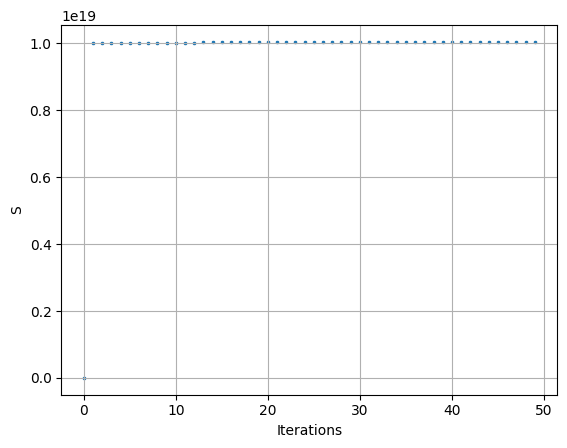

In [4]:
plt.scatter(np.arange(0,iterations), s_array, s=3, marker='x')
plt.xlabel('Iterations')
plt.ylabel('S')
plt.grid()
plt.show()

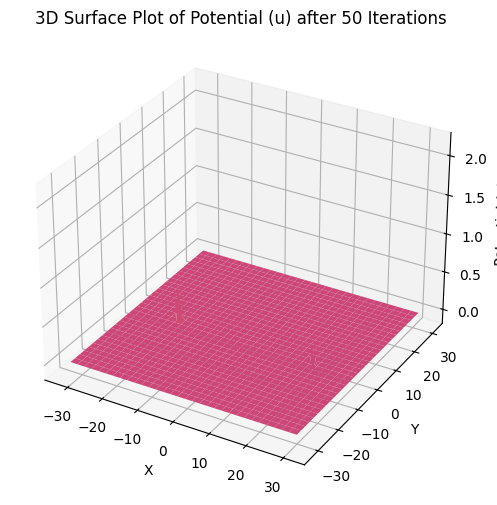

In [5]:
from matplotlib import colors

# Setting a consistent normalization for both plots
norm = colors.TwoSlopeNorm(vmin=-np.max(PS.u_grid), vcenter=0, vmax=np.max(PS.u_grid))


#Plot the u_grid after 500 iterations
x = np.linspace(-PS.size//2, PS.size//2, PS.size)
y = np.linspace(-PS.size//2, PS.size//2, PS.size)
X, Y = np.meshgrid(x, y)

fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')

ax.plot_surface(X, Y, PS.u_grid, cmap='plasma', edgecolor='none', norm = norm)
ax.set_title(f'3D Surface Plot of Potential (u) after {PS.nr_iterations} Iterations')
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Potential (u)')
plt.show()

In [6]:
from poison2dsolver import PoissonSolver2D
from poison2dsolver import PoissonSolver2DFast

A = PoissonSolver2DFast()
B = PoissonSolver2D()

print(A.ro_grid)
print(B.ro_grid)

[[-1.34166889e-46 -6.07285709e-45 -2.42579426e-43 ... -2.42579426e-43
  -6.07285709e-45 -1.34166889e-46]
 [-3.68337402e-45 -1.66722238e-43 -6.65969645e-42 ... -6.65969645e-42
  -1.66722238e-43 -3.68337402e-45]
 [-8.92399835e-44 -4.03931008e-42 -1.61349675e-40 ... -1.61349675e-40
  -4.03931008e-42 -8.92399835e-44]
 ...
 [ 8.92399835e-44  4.03931008e-42  1.61349675e-40 ...  1.61349675e-40
   4.03931008e-42  8.92399835e-44]
 [ 3.68337402e-45  1.66722238e-43  6.65969645e-42 ...  6.65969645e-42
   1.66722238e-43  3.68337402e-45]
 [ 1.34166889e-46  6.07285709e-45  2.42579426e-43 ...  2.42579426e-43
   6.07285709e-45  1.34166889e-46]]
[[-1.34166889e-46 -6.07285709e-45 -2.42579426e-43 ... -2.42579426e-43
  -6.07285709e-45 -1.34166889e-46]
 [-3.68337402e-45 -1.66722238e-43 -6.65969645e-42 ... -6.65969645e-42
  -1.66722238e-43 -3.68337402e-45]
 [-8.92399835e-44 -4.03931008e-42 -1.61349675e-40 ... -1.61349675e-40
  -4.03931008e-42 -8.92399835e-44]
 ...
 [ 8.92399835e-44  4.03931008e-42  1.6134967

In [7]:
A.ro_grid==B.ro_grid

array([[ True,  True,  True, ...,  True,  True,  True],
       [ True,  True,  True, ...,  True,  True,  True],
       [ True,  True,  True, ...,  True,  True,  True],
       ...,
       [ True,  True,  True, ...,  True,  True,  True],
       [ True,  True,  True, ...,  True,  True,  True],
       [ True,  True,  True, ...,  True,  True,  True]])